# CS5344 Project: News Popularity Analysis across different Social Media Platforms

## Setup and Imports

In [1]:
#setup Pyspark
!pip install pyspark
!pip install wordcloud
!pip install plotly

In [2]:
#importing the required libraries
from pyspark import SparkConf, SparkContext, SQLContext
import re

import nltk
from nltk.corpus import stopwords
from wordcloud import WordCloud,STOPWORDS
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from matplotlib import pyplot as plt
%matplotlib inline

from sklearn.preprocessing import StandardScaler
import plotly.express as px

In [3]:
#Connect to google drive

# from google.colab import drive
# drive.mount('/content/drive')
import warnings
warnings.filterwarnings('ignore')

## Initialization of Spark


In [ ]:
#Use this only if you need to restart pyspark instead of having to restart the entire runtime.
#sc.stop()

In [4]:
conf=SparkConf()
sc=SparkContext(conf=conf)
sqlContext = SQLContext(sc)

22/11/10 17:03:37 WARN Utils: Your hostname, Vaishnavis-MacBook-Pro.local resolves to a loopback address: 127.0.0.1; using 192.168.18.5 instead (on interface en0)
22/11/10 17:03:37 WARN Utils: Set SPARK_LOCAL_IP if you need to bind to another address


Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).


22/11/10 17:03:38 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable


##Reading Data From CSV files

In [5]:
#Reading data from csv files
#read lexicon data set from google drive
lexicon = sqlContext.read.csv('lexicon.csv', header=True)

#read news data set from google drive
# query = sqlContext.read.csv('/content/drive/MyDrive/NUS_Mcomp/Big_Data/News_Final.csv',header=True)
query = sqlContext.read.option("escape", "\"").csv('News_Final.csv',header=True)
#remove duplicates
query = query.distinct()

#create dictionary for lexicon. Only using keywords and sentiment score
lexicon_dict = lexicon.rdd.map(lambda m:(m[0],m[2])).collectAsMap()


## Method 1 : Sentiment Lexicon

### Function to Compute Sentiment 

In [6]:
#function to compute sentiment for a given string
def computeSentiment(input):
    if input == "" or input is None:
        return 0
    else:
        total = 0
        positive = 0
        negative = 0
        for i in input.split():
            #remove decimals from lab sample code
            word = re.split(r'[^\w]+',i)
            #remove special characters
            word = word[0].encode("ascii","ignore").decode().lower()
            if i in lexicon_dict.keys():
                sentiment = int(lexicon_dict[i])
                if sentiment > 0:
                    positive +=1
                elif sentiment < 0:
                    negative+=1
            total+=1
        if total == 0:
            return 0
        else:
            return ((positive-negative)/total)


### Sentiment For Title

In [7]:
#filter for only ID & title
title = query.rdd.map(lambda m: (m[0],m[1]))


#compute sentiment for titles
title = title.map(lambda m: (m[0],computeSentiment(m[1])))
title_df = title.toDF(["ID","NewTitleSentiment"])
title_df.show(truncate =False)


+-----+------------------+
|ID   |NewTitleSentiment |
+-----+------------------+
|27894|0.0               |
|62218|0.0               |
|62182|0.0               |
|63282|0.0               |
|81   |0.0               |
|6    |0.0               |
|960  |0.0               |
|62960|0.1               |
|551  |0.0               |
|917  |0.0               |
|1036 |0.0               |
|1211 |0.0               |
|1591 |0.0               |
|1728 |0.0               |
|2107 |0.0               |
|2476 |0.0               |
|2356 |0.0               |
|2975 |0.0               |
|2541 |0.0               |
|2538 |0.1111111111111111|
+-----+------------------+
only showing top 20 rows



### Sentiment for Headline

In [8]:
#filter for only ID & headline
headline = query.rdd.map(lambda m: (m[0],m[2]))

#compute sentiment for headline
headline = headline.map(lambda m: (m[0], computeSentiment(m[1])))
headline_df = headline.toDF(["ID","NewHeadlineSentiment"])
headline_df.show()

+-----+--------------------+
|   ID|NewHeadlineSentiment|
+-----+--------------------+
|27894|                 0.0|
|62218|-0.03278688524590164|
|62182|                 0.0|
|63282|                 0.0|
|   81|                 0.0|
|    6|0.043478260869565216|
|  960|0.038461538461538464|
|62960|                0.04|
|  551|-0.04347826086956...|
|  917|0.043478260869565216|
| 1036|                 0.0|
| 1211| 0.08695652173913043|
| 1591| 0.08333333333333333|
| 1728|                 0.0|
| 2107|                 0.0|
| 2476| 0.14285714285714285|
| 2356|                 0.0|
| 2975| 0.09090909090909091|
| 2541| 0.15789473684210525|
| 2538|                 0.0|
+-----+--------------------+
only showing top 20 rows



### Joining new headline and title sentiment to original dataframe

In [11]:
#join new headline and title sentiment to original dataframe
query_new_sentiment = query.join(headline_df, query.IDLink == headline_df.ID, "left").drop('ID')


query_new_sentiment = query_new_sentiment.join(title_df, query_new_sentiment.IDLink == title_df.ID, "left").drop('ID')

query_new_sentiment.show()

+------+--------------------+--------------------+--------------------+---------+-------------------+-------------------+-------------------+--------+----------+--------+--------------------+------------------+
|IDLink|               Title|            Headline|              Source|    Topic|        PublishDate|     SentimentTitle|  SentimentHeadline|Facebook|GooglePlus|LinkedIn|NewHeadlineSentiment| NewTitleSentiment|
+------+--------------------+--------------------+--------------------+---------+-------------------+-------------------+-------------------+--------+----------+--------+--------------------+------------------+
|  1728|Microsoft's Terra...|&quot;The tempera...|         Motherboard|microsoft|2015-11-13 14:40:14| -0.166666666666667|-0.0191366386154936|     450|        74|     190|                 0.0|               0.0|
|  2975|How to Find a Ban...|Bank Local, a new...|           Next City|  economy|2015-11-17 00:00:00| 0.0659556066263858| -0.284969699211335|      -1|      

## Method 2 : Frequent Words

### Converting to Pandas Dataframe

In [12]:
#converting to pandas dataframe
query_new_sentiment_df = query_new_sentiment.select("*").toPandas()
query_new_sentiment_df.to_csv('News_main.csv') #saving to new sentiment score as a new csv file
query_new_sentiment_df.head()

,IDLink,Title,Headline,Source,Topic,PublishDate,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,NewHeadlineSentiment,NewTitleSentiment
0,64038,Hollande wrong to follow Obama in dividing ter...,The Western trend of splitting terrorists into...,RT,obama,2015-11-27 19:24:37,-0.0471111475902756,-0.00420051387297002,471,93,0,-0.083333,-0.083333
1,691,"No, Boomers Aren't What's Wrong With The Economy","He just attacked baby boomers """"""and the way t...",Forbes,economy,2015-11-10 16:37:13,0.0626084129175588,0.0159117211630411,14,1,7,0.043478,0.000000
2,64985,Obama Administration Targets 'Unbanked' Househ...,The Obama administration launched a new initia...,Wall Street Journal (blog),obama,2015-12-02 16:24:40,0.0393712992717946,0.118201357211163,12,3,10,0.142857,0.000000
3,6731,Mongolia's economic crisis: an end to corporat...,"Despite an economic crisis, some Mongolian com...",Open Democracy,economy,2015-12-03 10:20:17,0,-0.0333210040737708,10,0,2,0.111111,0.000000
4,64747,Obama's Paris climate treaty spells doom for TPP,President Obama will sign on to some form of a...,The Hill (blog),obama,2015-12-01 13:24:37,-0.265165042944955,0.075977691674607,522,2,26,-0.037037,-0.125000


### Frequent Words in Title 

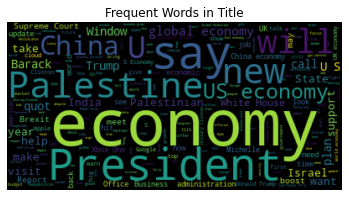

In [13]:
#most frequenlty used words in title

# Create stopword list:
stopwords = set(STOPWORDS)
stopwords.update(["obama", "Microsoft"]) 

#joining all the titles in the dataframe to a single string  
text = " ".join(title for title in query_new_sentiment_df.Title)
#generating the wordcloud for the titles
wordcloud = WordCloud(stopwords=stopwords).generate(text)
#plotting the wordcloud
plt.title("Frequent Words in Title")
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

### Frequent Words in Headline

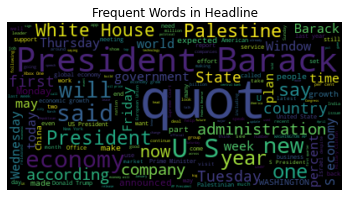

In [14]:
#most frequenlty used words in headline
stopwords.update(["obama", "Microsoft"]) 
#joining all the headlines in the dataframe to a single string  
text = " ".join(headline for headline in query_new_sentiment_df.Headline if headline!= None)
#generating the wordcloud for the headline
wordcloud = WordCloud(stopwords=stopwords).generate(text)
#plotting the wordcloud
plt.title("Frequent Words in Headline")
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

### Splitting the Data Based on Positive and Negative Tentiment

In [15]:
query_new_sentiment_df['SentimentChange_Title']=query_new_sentiment_df['NewTitleSentiment'].apply(lambda x : +1 if x >= 0 else -1)
query_new_sentiment_df['SentimentChange_Headline']=query_new_sentiment_df['NewHeadlineSentiment'].apply(lambda x : +1 if x >= 0 else -1)
query_new_sentiment_df.head()

,IDLink,Title,Headline,Source,Topic,PublishDate,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,NewHeadlineSentiment,NewTitleSentiment,SentimentChange_Title,SentimentChange_Headline
0,64038,Hollande wrong to follow Obama in dividing ter...,The Western trend of splitting terrorists into...,RT,obama,2015-11-27 19:24:37,-0.0471111475902756,-0.00420051387297002,471,93,0,-0.083333,-0.083333,-1,-1
1,691,"No, Boomers Aren't What's Wrong With The Economy","He just attacked baby boomers """"""and the way t...",Forbes,economy,2015-11-10 16:37:13,0.0626084129175588,0.0159117211630411,14,1,7,0.043478,0.000000,1,1
2,64985,Obama Administration Targets 'Unbanked' Househ...,The Obama administration launched a new initia...,Wall Street Journal (blog),obama,2015-12-02 16:24:40,0.0393712992717946,0.118201357211163,12,3,10,0.142857,0.000000,1,1
3,6731,Mongolia's economic crisis: an end to corporat...,"Despite an economic crisis, some Mongolian com...",Open Democracy,economy,2015-12-03 10:20:17,0,-0.0333210040737708,10,0,2,0.111111,0.000000,1,1
4,64747,Obama's Paris climate treaty spells doom for TPP,President Obama will sign on to some form of a...,The Hill (blog),obama,2015-12-01 13:24:37,-0.265165042944955,0.075977691674607,522,2,26,-0.037037,-0.125000,-1,-1


#### Splitting based on Title Sentiment

In [16]:
# split df - positive and negative sentiment based on title:
positive_sentiment_title_df = query_new_sentiment_df[query_new_sentiment_df['SentimentChange_Title'] == 1]

negative_sentiment_title_df = query_new_sentiment_df[query_new_sentiment_df['SentimentChange_Title'] == -1]

#### Splitting based on Headline Sentiment

In [17]:
# split df - positive and negative sentiment based on headline:
positive_sentiment_headline_df = query_new_sentiment_df[query_new_sentiment_df['SentimentChange_Headline'] == 1]
negative_sentiment_headline_df = query_new_sentiment_df[query_new_sentiment_df['SentimentChange_Headline'] == -1]

### Frequent Positive Words based on Title

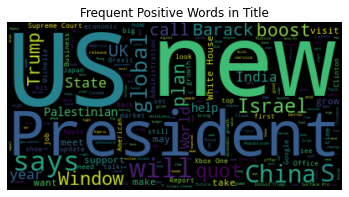

In [18]:
#frequent words that makes the news positive based on title
stopwords = set(STOPWORDS)
stopwords.update(["obama", "Microsoft","economy","palestine","U","say"]) 

## obama,microsoft,economy,palestine, U and say removed because they were included in negative sentiment

pos = " ".join(title for title in positive_sentiment_title_df.Title)  # joining all the titles in the  positive dataframe to a single string  
wordcloud2 = WordCloud(stopwords=stopwords).generate(pos) # generating the wordcloud for the titles
plt.title("Frequent Positive Words in Title")
plt.imshow(wordcloud2, interpolation='bilinear') #plotting the wordcloud
plt.axis("off")
plt.show()

### Frequent Negative Words based on Title

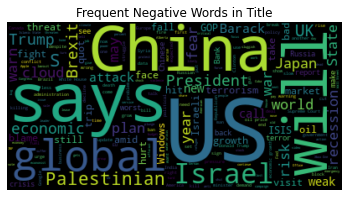

In [19]:
#frequent words that makes the news negative based on title
stopwords = set(STOPWORDS)
stopwords.update(["obama", "Microsoft","economy","palestine","U","say"]) 

## obama,microsoft,economy,palestine, U and say removed because they were included in positive sentiment

neg = " ".join(title for title in negative_sentiment_title_df.Title)
wordcloud2 = WordCloud(stopwords=stopwords).generate(neg)
plt.title("Frequent Negative Words in Title")
plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis("off")
plt.show()

### Frequent Positive Words based on Headline

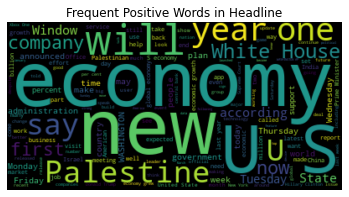

In [20]:
#frequent words that makes the news positive based on headline
stopwords = set(STOPWORDS)
stopwords.update(["obama", "Microsoft","quot","barack","president","said"]) 

## obama,microsoft,quot,barack,president and said removed because they were included in negative sentiment

pos = " ".join(headline for headline in positive_sentiment_headline_df.Headline)
wordcloud2 = WordCloud(stopwords=stopwords).generate(pos)
plt.title("Frequent Positive Words in Headline")
plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis("off")
plt.show()

### Frequent Negative Words based on Headline

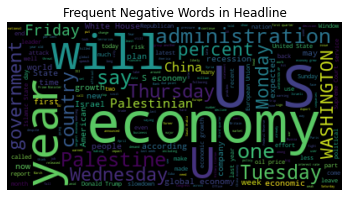

In [21]:
#frequent words that makes the news negative based on headline
stopwords = set(STOPWORDS)
stopwords.update(["obama", "Microsoft","quot","barack","president","said"]) 

## obama,microsoft,quot,barack,president and said removed because they were included in positive sentiment

neg = " ".join(headline for headline in negative_sentiment_headline_df.Headline if headline!= None)
wordcloud2 = WordCloud(stopwords=stopwords).generate(neg)
plt.title("Frequent Negative Words in Headline")
plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis("off")
plt.show()

### Splitting data based positive and negative sentiment across different platform

In [22]:
# split df - positive and negative sentiment based on title:
import warnings
warnings.filterwarnings('ignore')
positive_sentiment_title_df_facebook = query_new_sentiment_df[query_new_sentiment_df['SentimentChange_Title'] == 1]
positive_sentiment_title_df_facebook['Facebook'] = positive_sentiment_title_df_facebook.Facebook.astype(int)
facebook_positive = positive_sentiment_title_df_facebook[positive_sentiment_title_df_facebook.Facebook > 1]


negative_sentiment_title_df_facebook = query_new_sentiment_df[query_new_sentiment_df['SentimentChange_Title'] == -1]
negative_sentiment_title_df_facebook['Facebook'] = negative_sentiment_title_df_facebook.Facebook.astype(int)
facebook_negative = negative_sentiment_title_df_facebook[negative_sentiment_title_df_facebook.Facebook > 1]

positive_sentiment_title_df_googleplus = query_new_sentiment_df[query_new_sentiment_df['SentimentChange_Headline'] == 1]
positive_sentiment_title_df_googleplus['GooglePlus'] = positive_sentiment_title_df_googleplus.Facebook.astype(int)
googleplus_positive = positive_sentiment_title_df_googleplus[positive_sentiment_title_df_googleplus.GooglePlus > 1]


negative_sentiment_title_df_googleplus = query_new_sentiment_df[query_new_sentiment_df['SentimentChange_Headline'] == -1]
negative_sentiment_title_df_googleplus['GooglePlus'] = negative_sentiment_title_df_googleplus.Facebook.astype(int)
googleplus_negative = negative_sentiment_title_df_googleplus[negative_sentiment_title_df_googleplus.GooglePlus > 1]

#### Positive Frequent Words and Negative Frequent Words based on Title popular on Facebook

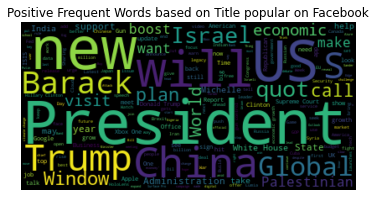

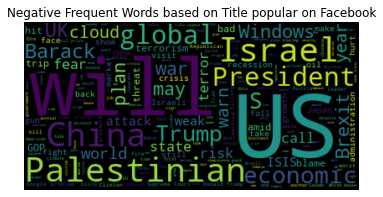

In [23]:
#frequent words that makes the news positive based on title popular on facebook
stopwords = set(STOPWORDS)
stopwords.update(["obama", "Microsoft","economy","palestine","U","says"]) 

## obama,microsoft,economy and palestine removed because they were included in negative sentiment

pos = " ".join(title for title in facebook_positive.Title)  # joining all the titles in the  positive dataframe to a single string  
wordcloud_1 = WordCloud(stopwords=stopwords).generate(pos) # generating the wordcloud for the titles
plt.title("Positive Frequent Words based on Title popular on Facebook")
plt.imshow(wordcloud_1, interpolation='bilinear')  # plotting the wordcloud
plt.axis("off")
plt.show()

#frequent words that makes the news positive based on title popular on facebook
stopwords = set(STOPWORDS)
stopwords.update(["obama", "Microsoft","economy","palestine","U","says"]) 

## obama,microsoft,economy and palestine removed because they were included in negative sentiment

pos = " ".join(title for title in facebook_negative.Title)  # joining all the titles in the  positive dataframe to a single string  
wordcloud_2 = WordCloud(stopwords=stopwords).generate(pos) # generating the wordcloud for the titles
plt.title("Negative Frequent Words based on Title popular on Facebook")
plt.imshow(wordcloud_2, interpolation='bilinear')  # plotting the wordcloud
plt.axis("off")
plt.show()

#### Positive Frequent Words and Negative Frequent Words based on Headline popular on Googleplus

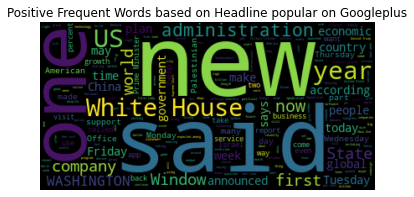

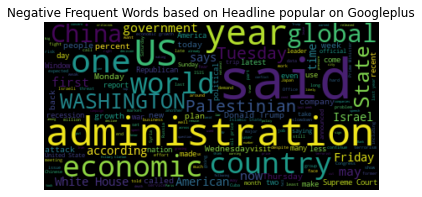

In [24]:
#frequent words that makes the news positive based on headline popular on googleplus
stopwords = set(STOPWORDS)
stopwords.update(["obama", "Microsoft","economy","palestine","U","say","President","Barack","quot","S","will"]) 

## obama,microsoft,economy and palestine removed because they were included in negative sentiment

pos = " ".join(headline for headline in googleplus_positive.Headline)  # joining all the headlines in the  positive dataframe to a single string  
wordcloud_1 = WordCloud(stopwords=stopwords).generate(pos) # generating the wordcloud for the titles
plt.title("Positive Frequent Words based on Headline popular on Googleplus")
plt.imshow(wordcloud_1, interpolation='bilinear')  # plotting the wordcloud
plt.axis("off")
plt.show()

#frequent words that makes the news positive based on headline popular on googleplus
stopwords = set(STOPWORDS)
stopwords.update(["obama", "Microsoft","economy","palestine","U","say","President","Barack","quot","S","will"]) 

## obama,microsoft,economy and palestine removed because they were included in negative sentiment

pos = " ".join(headline for headline in googleplus_negative.Headline if headline != None)  # joining all the headlines in the  positive dataframe to a single string  
wordcloud_2 = WordCloud(stopwords=stopwords).generate(pos) # generating the wordcloud for the titles
plt.title("Negative Frequent Words based on Headline popular on Googleplus")
plt.imshow(wordcloud_2, interpolation='bilinear')  # plotting the wordcloud
plt.axis("off")
plt.show()

## Method 3 : Clustering

In [26]:
#@title For clustering and Converting to Pandas Dataframe
full_dataset_news = pd.read_csv('News_Final.csv')
# query_new_sentiment.head(3)

In [27]:
fullClusterdata = query_new_sentiment.toPandas()

In [28]:
clusterdata_source = fullClusterdata[["IDLink", "Source","NewHeadlineSentiment","NewTitleSentiment"]]

In [29]:
clusterdata_source.dropna()

,IDLink,Source,NewHeadlineSentiment,NewTitleSentiment
0,64038,RT,-0.083333,-0.083333
1,691,Forbes,0.043478,0.000000
2,64985,Wall Street Journal (blog),0.142857,0.000000
3,6731,Open Democracy,0.111111,0.000000
4,64747,The Hill (blog),-0.037037,-0.125000
...,...,...,...,...
93230,104314,NPR,0.000000,0.000000
93231,99098,Sputnik International,0.090909,0.000000
93232,53775,Herald Scotland,-0.041667,-0.090909
93233,101262,MTV.com,0.000000,0.000000


In [30]:
sampledataset = clusterdata_source.head(500)

Text(0.5, 1.0, 'NewsID vs HeadlineSentimentScore')

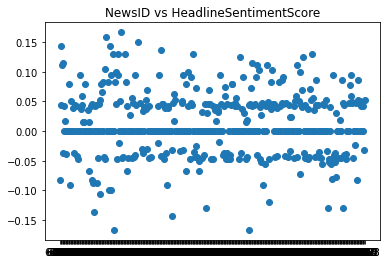

In [31]:
plt.scatter(sampledataset['IDLink'],sampledataset['NewHeadlineSentiment'])
plt.title('NewsID vs HeadlineSentimentScore')



In [32]:
#Removing the data which contain HeadlineSentiment Score as 0
testingclusters = sampledataset[(sampledataset['NewHeadlineSentiment']!=0.0) & (sampledataset['NewTitleSentiment']!=0.0)]


Text(0.5, 1.0, 'NewsID vs HeadlineSentimentScore without data with Sentiment Score 0')

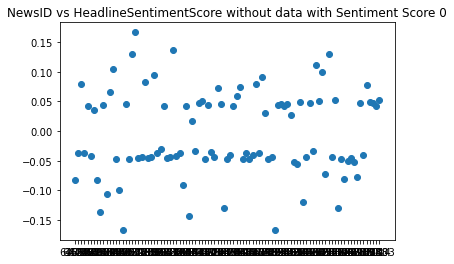

In [33]:
plt.scatter(testingclusters['IDLink'],testingclusters['NewHeadlineSentiment'])
plt.title('NewsID vs HeadlineSentimentScore without data with Sentiment Score 0')

In [34]:
km = KMeans(n_clusters=3)
y_predicted = km.fit_predict(testingclusters[['NewHeadlineSentiment']])
y_predicted

array([0, 0, 1, 0, 1, 0, 1, 0, 2, 1, 2, 1, 1, 0, 2, 2, 1, 0, 1, 1, 0, 0,
       1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 2, 1, 2, 1, 0, 1, 1, 0, 1, 0,
       0, 1, 1, 2, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 2, 1, 1,
       1, 1, 1, 0, 0, 1, 2, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 2, 0, 0, 0, 0,
       0, 0, 1, 0, 1, 1, 1, 1, 1], dtype=int32)

In [35]:
testingclusters['cluster']=y_predicted
testingclusters = testingclusters.sort_values(by = ['cluster'])
testingclusters


,IDLink,Source,NewHeadlineSentiment,NewTitleSentiment,cluster
0,64038,RT,-0.083333,-0.083333,0
173,62299,Associated Press via Yahoo! News,-0.037037,-0.111111,0
196,90436,Fox News,-0.033333,-0.047619,0
213,101228,Palestine News Network,-0.047619,-0.111111,0
219,8502,Computerworld,-0.035714,-0.100000,0
...,...,...,...,...,...
65,66000,The Courier-Journal,-0.105263,-0.142857,2
343,103559,The Washington Times,-0.120000,-0.083333,2
89,38318,The Straits Times,-0.166667,-0.200000,2
439,85699,Israel Hayom,-0.130435,-0.142857,2


In [36]:
testingclusters['row_num'] = np.arange(len(testingclusters))
testingclusters

,IDLink,Source,NewHeadlineSentiment,NewTitleSentiment,cluster,row_num
0,64038,RT,-0.083333,-0.083333,0,0
173,62299,Associated Press via Yahoo! News,-0.037037,-0.111111,0,1
196,90436,Fox News,-0.033333,-0.047619,0,2
213,101228,Palestine News Network,-0.047619,-0.111111,0,3
219,8502,Computerworld,-0.035714,-0.100000,0,4
...,...,...,...,...,...,...
65,66000,The Courier-Journal,-0.105263,-0.142857,2,92
343,103559,The Washington Times,-0.120000,-0.083333,2,93
89,38318,The Straits Times,-0.166667,-0.200000,2,94
439,85699,Israel Hayom,-0.130435,-0.142857,2,95


In [37]:
km.cluster_centers_

array([[-0.04724122],
       [ 0.06430712],
       [-0.12895959]])

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


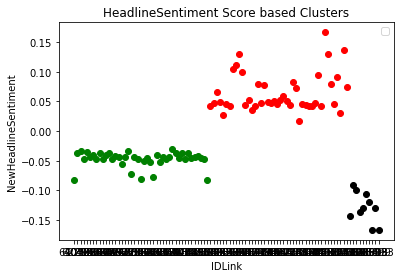

In [38]:
df1 = testingclusters[testingclusters.cluster==0]
df2 = testingclusters[testingclusters.cluster==1]
df3 = testingclusters[testingclusters.cluster==2]
plt.scatter(df1.IDLink,df1['NewHeadlineSentiment'],color='green')
plt.scatter(df2.IDLink,df2['NewHeadlineSentiment'],color='red')
plt.scatter(df3.IDLink,df3['NewHeadlineSentiment'],color='black')
plt.xlabel('IDLink')
plt.ylabel('NewHeadlineSentiment')
plt.title('HeadlineSentiment Score based Clusters')
plt.legend()

In [39]:
fullClusterdata['Topic'].unique()

array(['obama', 'economy', 'palestine', 'microsoft'], dtype=object)

In [40]:
k_range = range(1,10)
sse = [] # SUM OF SQUARED ERROR
for k in k_range:
    km = KMeans(n_clusters=k)
    km.fit(testingclusters[['NewHeadlineSentiment']]) # same result for NewTitleSentiment
    sse.append(km.inertia_)

In [41]:
sse

[0.500848226953991,
 0.11328922187700971,
 0.05911009429489291,
 0.02589224429752554,
 0.01683824751223645,
 0.009025915782169151,
 0.007318562247633767,
 0.005585621449765042,
 0.004424594603500718]

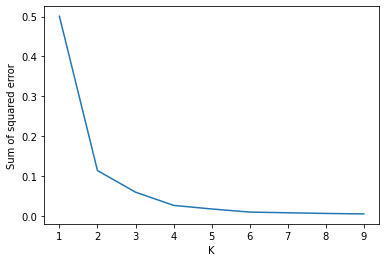

In [42]:
plt.xlabel('K')
plt.ylabel('Sum of squared error')
plt.plot(k_range,sse)

Text(0.5, 1.0, 'NewsID vs TitleSentimentScore')

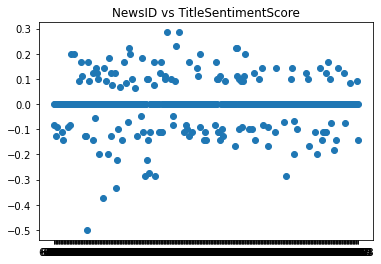

In [43]:
plt.scatter(sampledataset['IDLink'],sampledataset['NewTitleSentiment'])
plt.title('NewsID vs TitleSentimentScore')


Text(0.5, 1.0, 'NewsID vs TitleSentimentScore without data having Sentiment Score 0')

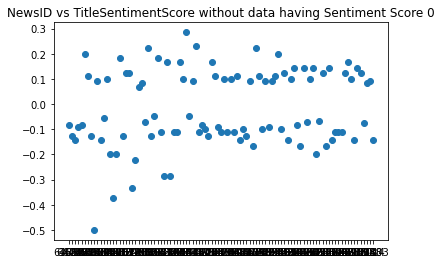

In [44]:
testingclusters = sampledataset[(sampledataset['NewHeadlineSentiment']!=0.0) & (sampledataset['NewTitleSentiment']!=0.0)]
plt.scatter(testingclusters['IDLink'],testingclusters['NewTitleSentiment'])
plt.title('NewsID vs TitleSentimentScore without data having Sentiment Score 0')

In [45]:
testingclusters['cluster']=y_predicted
testingclusters = testingclusters.sort_values(by = ['cluster'])
testingclusters

,IDLink,Source,NewHeadlineSentiment,NewTitleSentiment,cluster
0,64038,RT,-0.083333,-0.083333,0
173,62299,Associated Press via Yahoo! News,-0.037037,-0.111111,0
196,90436,Fox News,-0.033333,-0.047619,0
213,101228,Palestine News Network,-0.047619,-0.111111,0
219,8502,Computerworld,-0.035714,-0.100000,0
...,...,...,...,...,...
65,66000,The Courier-Journal,-0.105263,-0.142857,2
343,103559,The Washington Times,-0.120000,-0.083333,2
89,38318,The Straits Times,-0.166667,-0.200000,2
439,85699,Israel Hayom,-0.130435,-0.142857,2


In [46]:
km = KMeans(n_clusters=3)
y_predicted = km.fit_predict(testingclusters[['NewTitleSentiment']])
y_predicted

array([1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 2, 0, 0, 1, 1, 1, 1, 1, 1,
       1, 0, 0, 0, 0, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 0, 0, 1, 1, 0,
       0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       1, 2, 2, 1, 1, 1, 1, 1, 1], dtype=int32)

In [47]:
testingclusters['cluster']=y_predicted
testingclusters = testingclusters.sort_values(by = ['cluster'])
testingclusters


,IDLink,Source,NewHeadlineSentiment,NewTitleSentiment,cluster
310,22184,Economic Times,0.043478,0.090909,0
436,32429,The Australian Financial Review,0.052632,0.142857,0
237,22043,The Guardian,0.045455,0.111111,0
186,27560,AFP via Yahoo! Finance,0.017241,0.285714,0
222,2161,PR Newswire,0.073171,0.166667,0
...,...,...,...,...,...
166,63241,Palestine Herald Press,-0.041667,-0.285714,2
102,102065,The Hindu,-0.045455,-0.333333,2
80,21535,BDlive,-0.100000,-0.375000,2
55,100964,American Thinker (blog),-0.136364,-0.500000,2


In [48]:
km.cluster_centers_

array([[ 0.13386046],
       [-0.11722155],
       [-0.35595238]])

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


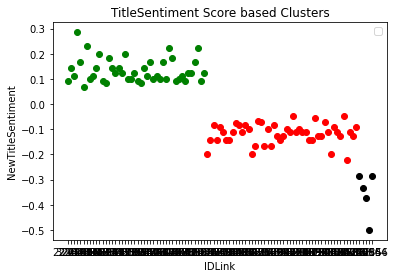

In [49]:
df1 = testingclusters[testingclusters.cluster==0]
df2 = testingclusters[testingclusters.cluster==1]
df3 = testingclusters[testingclusters.cluster==2]
plt.scatter(df1.IDLink,df1['NewTitleSentiment'],color='green')
plt.scatter(df2.IDLink,df2['NewTitleSentiment'],color='red')
plt.scatter(df3.IDLink,df3['NewTitleSentiment'],color='black')
plt.xlabel('IDLink')
plt.ylabel('NewTitleSentiment')
plt.title('TitleSentiment Score based Clusters')
plt.legend()

In [50]:
k_range = range(1,10)
sse = [] # SUM OF SQUARED ERROR
for k in k_range:
    km = KMeans(n_clusters=k)
    km.fit(testingclusters[['NewTitleSentiment']])
    sse.append(km.inertia_)

In [51]:
sse

[2.2611483515081208,
 0.46144462427932775,
 0.20336579159288806,
 0.13277367640482823,
 0.0859913098155335,
 0.06474468605915135,
 0.045014717784922255,
 0.03151657012933104,
 0.027346110391574717]

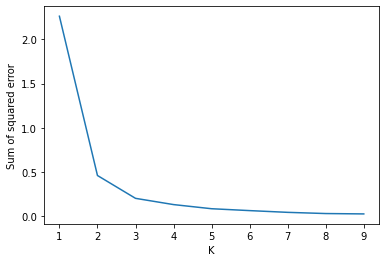

In [52]:
plt.xlabel('K')
plt.ylabel('Sum of squared error')
plt.plot(k_range,sse)

## Analysis and Visualization

### Categorizing SentimentTitle and SentimentHeadline - 3 categories: positive,negative and neutral

In [53]:
#Categorizing SentimentTitle and SentimentHeadline - 3 categroies : positive,negative and neutral
query_new_sentiment_df_copy = query_new_sentiment_df.copy()
query_new_sentiment_df_copy = query_new_sentiment_df_copy.drop(columns=['SentimentChange_Title','SentimentChange_Headline'])
query_new_sentiment_df_copy['SentimentTitle_Category'] = query_new_sentiment_df_copy['NewTitleSentiment'].apply(lambda x: 'neutral' if x == 0 else 'positive' if x > 0 else 'negative')

query_new_sentiment_df_copy['SentimentHeadline_Category'] = query_new_sentiment_df_copy['NewHeadlineSentiment'].apply(lambda x: 'neutral' if x == 0 else 'positive' if x > 0 else 'negative')
query_new_sentiment_df_copy.head()

,IDLink,Title,Headline,Source,Topic,PublishDate,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,NewHeadlineSentiment,NewTitleSentiment,SentimentTitle_Category,SentimentHeadline_Category
0,64038,Hollande wrong to follow Obama in dividing ter...,The Western trend of splitting terrorists into...,RT,obama,2015-11-27 19:24:37,-0.0471111475902756,-0.00420051387297002,471,93,0,-0.083333,-0.083333,negative,negative
1,691,"No, Boomers Aren't What's Wrong With The Economy","He just attacked baby boomers """"""and the way t...",Forbes,economy,2015-11-10 16:37:13,0.0626084129175588,0.0159117211630411,14,1,7,0.043478,0.000000,neutral,positive
2,64985,Obama Administration Targets 'Unbanked' Househ...,The Obama administration launched a new initia...,Wall Street Journal (blog),obama,2015-12-02 16:24:40,0.0393712992717946,0.118201357211163,12,3,10,0.142857,0.000000,neutral,positive
3,6731,Mongolia's economic crisis: an end to corporat...,"Despite an economic crisis, some Mongolian com...",Open Democracy,economy,2015-12-03 10:20:17,0,-0.0333210040737708,10,0,2,0.111111,0.000000,neutral,positive
4,64747,Obama's Paris climate treaty spells doom for TPP,President Obama will sign on to some form of a...,The Hill (blog),obama,2015-12-01 13:24:37,-0.265165042944955,0.075977691674607,522,2,26,-0.037037,-0.125000,negative,negative


### Function to get the count of each items falling in each category based on sentiment score

In [54]:
#to get the count of each items falling in each category based on sentiment score
def number_of_news_title_sentiment(df):
    print('No. of News of each category based on the SentimentTitle')
    print(df.SentimentTitle_Category.value_counts(),'\n')

    plt.figure(figsize=(10,8))
    df.SentimentTitle_Category.value_counts().plot(kind='bar')
    plt.title('News Items Distribution of Each category based on Sentiment score of  Title', fontdict={'size':20, 'fontweight' : 'bold'})
    plt.xlabel('Sentiment Category',fontdict={'size':15})
    plt.ylabel('No. of News',fontdict={'size':15})

def number_of_news_headline_sentiment(df):
    print('No. of News of each category based on the SentimentHeadline')
    print(df.SentimentHeadline_Category.value_counts(),'\n')

    plt.figure(figsize=(10,8))
    df.SentimentHeadline_Category.value_counts().plot(kind='bar')
    plt.title('News Items Distribution of Each category based on Sentiment score of Headline', fontdict={'size':20, 'fontweight' : 'bold'})
    plt.xlabel('Sentiment Category',fontdict={'size':15})
    plt.ylabel('No. of News',fontdict={'size':15})

### News Items Distribution of Each category based on Sentiment score of  Title

No. of News of each category based on the SentimentTitle
neutral     67262
positive    13630
negative    12343
Name: SentimentTitle_Category, dtype: int64 



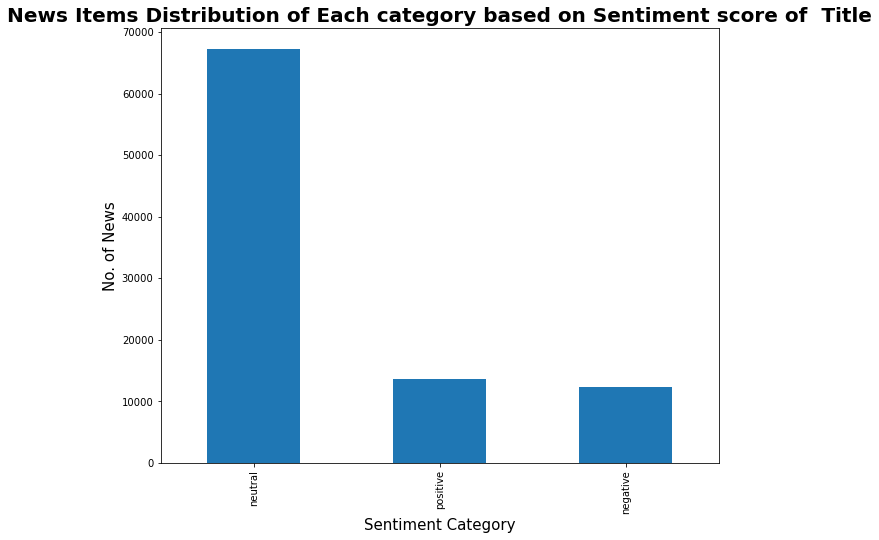

In [55]:
number_of_news_title_sentiment(query_new_sentiment_df_copy)

### News Items Distribution of Each category based on Sentiment score of Headline

No. of News of each category based on the SentimentHeadline
neutral     38546
positive    33213
negative    21476
Name: SentimentHeadline_Category, dtype: int64 



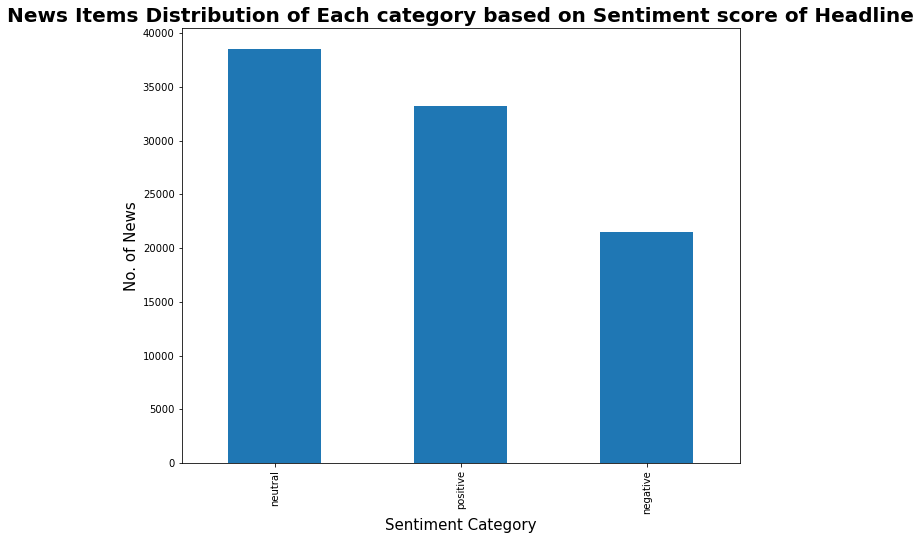

In [56]:
number_of_news_headline_sentiment(query_new_sentiment_df_copy)

### Popularity comparison based on different social media platform

#### Scarlar Transformation on Platform

In [57]:
#Applying Standard scalar transformation on platform popularity column
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
platforms = ['Facebook', 'GooglePlus', 'LinkedIn']

for platform in platforms:
    master = query_new_sentiment_df_copy[platform].apply(lambda x:x if x!=(0) else np.nan)  # We excluded level 0 because actually it's level -1, which we are not considering. 
    query_new_sentiment_df_copy[f'{platform}_scaled'] = scaler.fit_transform(master.values.reshape(-1,1))

    query_new_sentiment_df_copy[f'{platform}_scaled'].fillna(0,inplace=True) # Reversed our first step.
    query_new_sentiment_df_copy[platform].fillna(0,inplace=True)
query_new_sentiment_df_copy.head()

,IDLink,Title,Headline,Source,Topic,PublishDate,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,NewHeadlineSentiment,NewTitleSentiment,SentimentTitle_Category,SentimentHeadline_Category,Facebook_scaled,GooglePlus_scaled,LinkedIn_scaled
0,64038,Hollande wrong to follow Obama in dividing ter...,The Western trend of splitting terrorists into...,RT,obama,2015-11-27 19:24:37,-0.0471111475902756,-0.00420051387297002,471,93,0,-0.083333,-0.083333,negative,negative,0.577013,4.818678,-0.107138
1,691,"No, Boomers Aren't What's Wrong With The Economy","He just attacked baby boomers """"""and the way t...",Forbes,economy,2015-11-10 16:37:13,0.0626084129175588,0.0159117211630411,14,1,7,0.043478,0.000000,neutral,positive,-0.159866,-0.156197,-0.061819
2,64985,Obama Administration Targets 'Unbanked' Househ...,The Obama administration launched a new initia...,Wall Street Journal (blog),obama,2015-12-02 16:24:40,0.0393712992717946,0.118201357211163,12,3,10,0.142857,0.000000,neutral,positive,-0.163091,-0.048048,-0.042397
3,6731,Mongolia's economic crisis: an end to corporat...,"Despite an economic crisis, some Mongolian com...",Open Democracy,economy,2015-12-03 10:20:17,0,-0.0333210040737708,10,0,2,0.111111,0.000000,neutral,positive,-0.166316,-0.210272,-0.094190
4,64747,Obama's Paris climate treaty spells doom for TPP,President Obama will sign on to some form of a...,The Hill (blog),obama,2015-12-01 13:24:37,-0.265165042944955,0.075977691674607,522,2,26,-0.037037,-0.125000,negative,negative,0.659247,-0.102122,0.061189


#### Topic-wise Popularity On Each Social Media Platform

In [58]:
#Popularity comparison based on different social media platform
topics = ['Economy','Microsoft', 'Obama', 'Palestine']
def populairty_across_topic_platform(df):
    facebook = abs(df.groupby(['Topic'])['Facebook_scaled'].sum())
    googleplus = abs(df.groupby(['Topic'])['GooglePlus_scaled'].sum())
    linkedin = abs(df.groupby(['Topic'])['LinkedIn_scaled'].sum())

    ind = np.arange(len(topics)) 


    plt.figure(figsize=(14,8))
    plt.bar(ind-0.25,facebook,width=0.25,label='Facebook')
    plt.bar(ind,googleplus,width=0.25,label='GooglePlus')
    plt.bar(ind+0.25,linkedin,width=0.25,label='LinkedIn')

    plt.xticks(ind, topics)
    plt.legend()
    plt.title('Topic-wise Popularity On Each Social Media Platform', fontdict={'size':20, 'fontweight' : 'bold'})
    plt.xlabel('Topics', fontdict={'size':15})
    plt.ylabel('Popularity Level', fontdict={'size':15})
    plt.show()

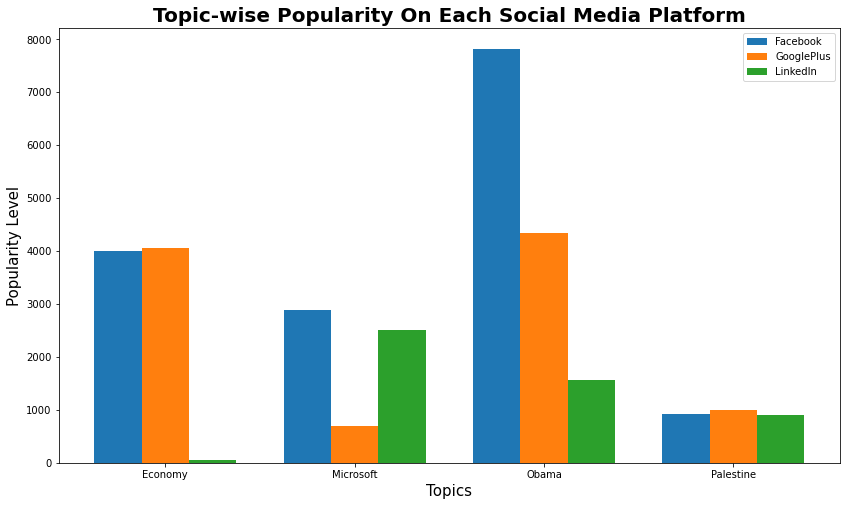

In [59]:
populairty_across_topic_platform(query_new_sentiment_df_copy)

### Relationship Between Sentiment, Topic and Popularity

In [60]:
#function to show relation between sentiment and other features based on plotly.express library
def relation_between_sentiment_and_other_features(df, sentimentType, feature):
    features = df[['Facebook', 'GooglePlus','LinkedIn','Topic', 'NewTitleSentiment','NewHeadlineSentiment']]

    fig = px.scatter(features, x=sentimentType, y=feature, color="Topic", symbol="Topic", title=f'Popularity Based on {Sentiment_Type}')
    fig.show()

#### Headline Sentiment VS LinkedIn

In [61]:
# Relationship between HeadlineSentiment and LinkedIn Across different topics
Sentiment_Type = "NewHeadlineSentiment" 
Platform = "LinkedIn" 
relation_between_sentiment_and_other_features(query_new_sentiment_df_copy, Sentiment_Type, Platform)

#### Headline Sentiment VS Facebook

In [62]:
# Relationship between HeadlineSentiment and Facebook Across different topics
Sentiment_Type = "NewHeadlineSentiment" 
Platform = "Facebook" 
relation_between_sentiment_and_other_features(query_new_sentiment_df_copy, Sentiment_Type, Platform)

#### TitleSentiment Vs GooglePlus

In [63]:
# Relationship between TitleSentiment and GooglePlus Across different topics
Sentiment_Type = "NewTitleSentiment" 
Platform = "GooglePlus" 
relation_between_sentiment_and_other_features(query_new_sentiment_df_copy, Sentiment_Type, Platform)

#### TitleSentiment Vs LinkedIn

In [64]:
# Relationship between TitleSentiment and LinkedIn Across different topics
Sentiment_Type = "NewTitleSentiment" 
Platform = "LinkedIn" 
relation_between_sentiment_and_other_features(query_new_sentiment_df_copy, Sentiment_Type, Platform)

### Bias Detection

In [65]:
from sklearn import preprocessing

# Create another copy of the dataframe
bias_df = query_new_sentiment_df.copy()

# Columns we are interested in
columns = ['SentimentTitle', 'SentimentHeadline', 'NewTitleSentiment', 'NewHeadlineSentiment']

# Do conversions of string types to floats for calculation
bias_df[columns] = bias_df[columns].apply(pd.to_numeric, errors='coerce', axis=1)
bias_df_raw = bias_df

# Normalize the sentiment scores
min_max_scaler = preprocessing.MinMaxScaler()
bias_df[columns] = min_max_scaler.fit_transform(bias_df[columns])
bias_df.head()

,IDLink,Title,Headline,Source,Topic,PublishDate,SentimentTitle,SentimentHeadline,Facebook,GooglePlus,LinkedIn,NewHeadlineSentiment,NewTitleSentiment,SentimentChange_Title,SentimentChange_Headline
0,64038,Hollande wrong to follow Obama in dividing ter...,The Western trend of splitting terrorists into...,RT,obama,2015-11-27 19:24:37,0.472327,0.436743,471,93,0,0.362069,0.500000,-1,-1
1,691,"No, Boomers Aren't What's Wrong With The Economy","He just attacked baby boomers """"""and the way t...",Forbes,economy,2015-11-10 16:37:13,0.529680,0.448436,14,1,7,0.545727,0.571429,1,1
2,64985,Obama Administration Targets 'Unbanked' Househ...,The Obama administration launched a new initia...,Wall Street Journal (blog),obama,2015-12-02 16:24:40,0.517533,0.507904,12,3,10,0.689655,0.571429,1,1
3,6731,Mongolia's economic crisis: an end to corporat...,"Despite an economic crisis, some Mongolian com...",Open Democracy,economy,2015-12-03 10:20:17,0.496953,0.419813,10,0,2,0.643678,0.571429,1,1
4,64747,Obama's Paris climate treaty spells doom for TPP,President Obama will sign on to some form of a...,The Hill (blog),obama,2015-12-01 13:24:37,0.358344,0.483356,522,2,26,0.429119,0.464286,-1,-1


In [66]:
# Compute the average across both the original sentiment scores and the new computed scores
bias_df_grouped = bias_df.groupby(['Topic', 'Source'], as_index=False)[columns].mean()
bias_df_grouped = bias_df_grouped[bias_df_grouped['Topic'] != ' ']
bias_df_grouped = bias_df_grouped[bias_df_grouped['Source'] != ' ']
bias_df_grouped.head()

,Topic,Source,SentimentTitle,SentimentHeadline,NewTitleSentiment,NewHeadlineSentiment
1,economy,/FILM,0.516754,0.465104,0.571429,0.424828
2,economy,10News,0.512450,0.402982,0.571429,0.424828
3,economy,10TV,0.474082,0.336996,0.571429,0.362069
4,economy,12NewsNow.Com,0.453392,0.314082,0.571429,0.356822
5,economy,12news.com,0.483917,0.390027,0.614286,0.512931


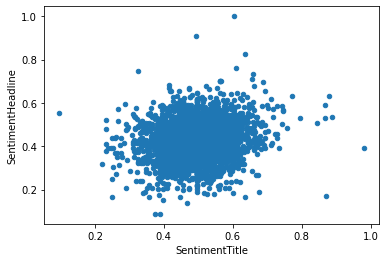

In [67]:
bias_df_grouped.plot.scatter(x='SentimentTitle', y='SentimentHeadline');

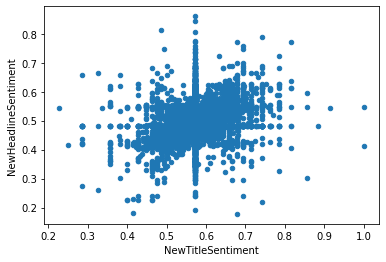

In [68]:
bias_df_grouped.plot.scatter(x='NewTitleSentiment', y='NewHeadlineSentiment');

In [69]:
from string import ascii_letters
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

bias_df_pivot = bias_df_grouped.pivot("Topic", "Source", "NewTitleSentiment")

In [70]:
bias_df_pivot.loc['total'] = bias_df_pivot.sum()
bias_df_pivot.sort_values(by='total', axis=1, inplace=True, ascending=False)
bias_df_pivot.drop(bias_df_pivot.tail(1).index, inplace=True)
bias_df_pivot

# plt.figure(figsize = (50,5))
# sns.heatmap(bias_df_pivot)

Source,The Nation,Livemint,Radio New Zealand,Memphis Commercial Appeal,Times of Malta,ABC 15 Phoenix,Brandon Sun,wwlp.com,Press Trust of India,Malay Mail Online,...,Sportskeeda,Examiner Gazette,Independent Florida Alligator,The Gadsden Times,WKYC-TV,The Vermilion,The Express Tribune (blog),Fleet Owner (blog),Topsail Voice,UTA The Shorthorn
Topic,,,,,,,,,,,,,,,,,,,,,
economy,0.598629,0.559784,0.596600,0.678571,0.594021,0.693878,0.591592,0.549490,0.563312,0.596096,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.285714,0.285714,NaN
microsoft,0.678571,0.590476,0.714286,0.742857,0.640306,0.693878,0.816327,0.714286,0.650000,0.666667,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
obama,0.857143,0.571429,0.603175,0.704762,0.571429,0.607143,0.575394,0.816327,0.714286,0.642857,...,NaN,NaN,NaN,0.285714,0.285714,NaN,NaN,NaN,NaN,NaN
palestine,0.601905,1.000000,0.785714,0.571429,0.761905,0.571429,0.571429,0.428571,0.571429,0.572715,...,0.337662,0.326531,0.326531,NaN,NaN,0.285714,0.285714,NaN,NaN,0.285714


<AxesSubplot:xlabel='Source', ylabel='Topic'>

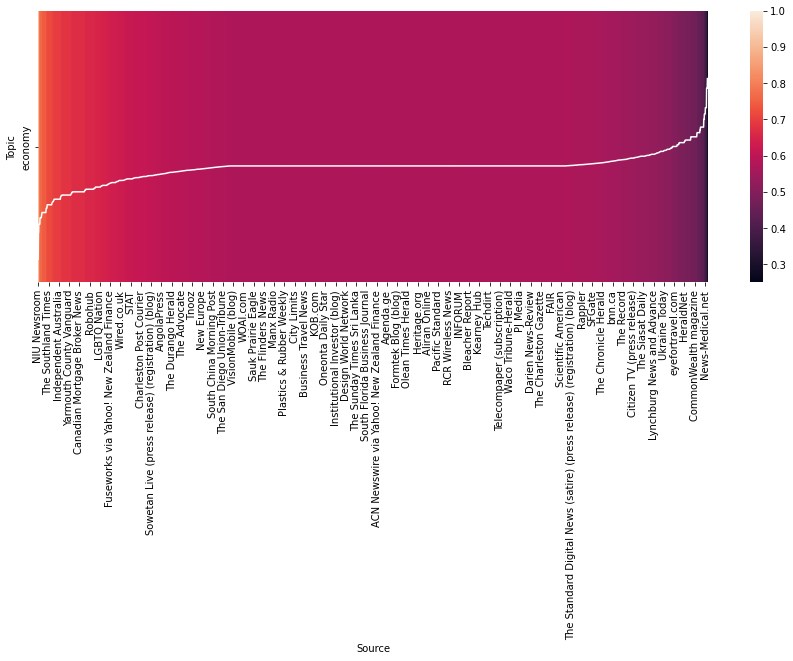

In [71]:
# Heatmap for Economy
bias_df_economy = bias_df_pivot.drop(bias_df_pivot.tail(3).index).sort_values(by='economy', axis=1, ascending=False)
bias_df_economy.dropna(axis=1, inplace=True)
plt.figure(figsize = (15,5))
sns.heatmap(bias_df_economy, cmap=sns.color_palette("rocket", as_cmap=True))

# Lineplot for Economy
plt.xticks(rotation=90)
sns.lineplot(x=bias_df_economy.columns[1:].tolist(), y=bias_df_economy.values[0][1:].tolist(), color='white')

<AxesSubplot:xlabel='Source', ylabel='Topic'>

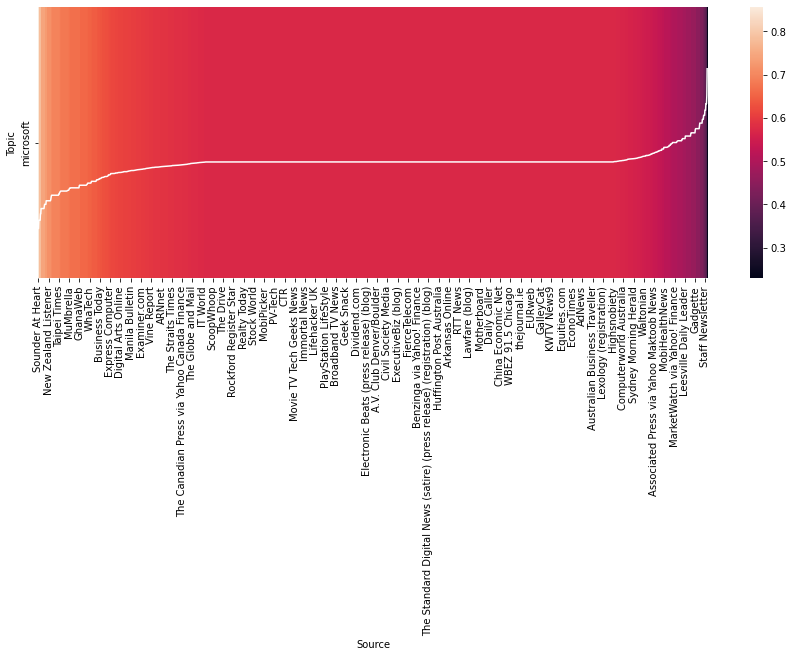

In [72]:
# Heatmap for Microsoft
bias_df_microsoft = bias_df_pivot.drop(bias_df_pivot.head(1).index).drop(bias_df_pivot.tail(2).index).sort_values(by='microsoft', axis=1, ascending=False)
bias_df_microsoft.dropna(axis=1, inplace=True)
plt.figure(figsize = (15,5))
sns.heatmap(bias_df_microsoft, cmap=sns.color_palette("rocket", as_cmap=True))

# Lineplot for Microsoft
plt.xticks(rotation=90)
sns.lineplot(x=bias_df_microsoft.columns[1:].tolist(), y=bias_df_microsoft.values[0][1:].tolist(), color='white')

<AxesSubplot:xlabel='Source', ylabel='Topic'>

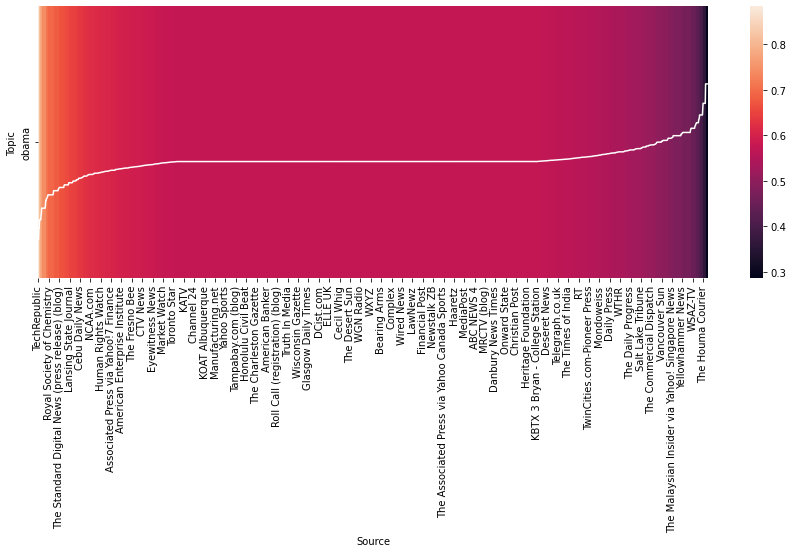

In [73]:
# Heatmap for Obama
bias_df_obama = bias_df_pivot.drop(bias_df_pivot.head(2).index).drop(bias_df_pivot.tail(1).index).sort_values(by='obama', axis=1, ascending=False)
bias_df_obama.dropna(axis=1, inplace=True)
plt.figure(figsize = (15,5))
sns.heatmap(bias_df_obama, cmap=sns.color_palette("rocket", as_cmap=True))

# Lineplot for Obama
plt.xticks(rotation=90)
sns.lineplot(x=bias_df_obama.columns[1:].tolist(), y=bias_df_obama.values[0][1:].tolist(), color='white')

<AxesSubplot:xlabel='Source', ylabel='Topic'>

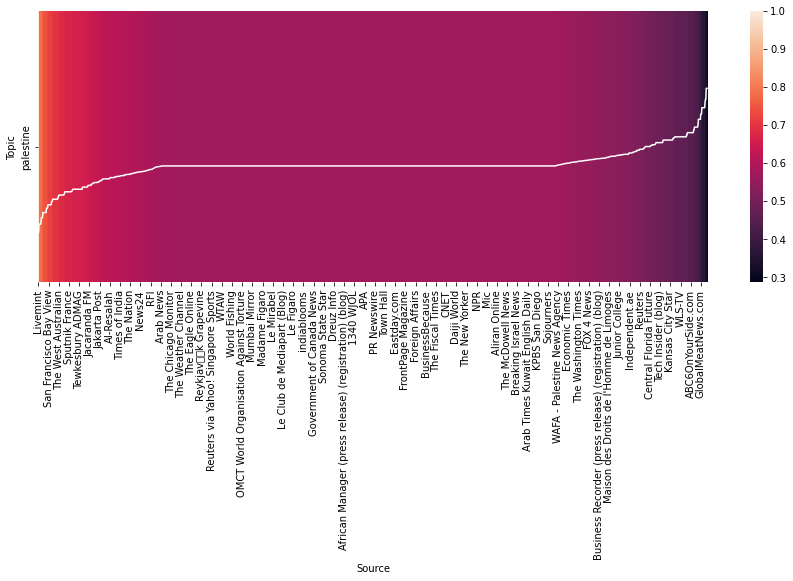

In [74]:
# Heatmap for Palestine
bias_df_palestine = bias_df_pivot.drop(bias_df_pivot.head(3).index).sort_values(by='palestine', axis=1, ascending=False)
bias_df_palestine.dropna(axis=1, inplace=True)
plt.figure(figsize = (15,5))
sns.heatmap(bias_df_palestine, cmap=sns.color_palette("rocket", as_cmap=True))

# Lineplot for Palestine
plt.xticks(rotation=90)
sns.lineplot(x=bias_df_palestine.columns[1:].tolist(), y=bias_df_palestine.values[0][1:].tolist(), color='white')

In [75]:
# Outlier Detection
topics = ['economy', 'microsoft', 'obama', 'palestine']
std = bias_df_pivot.T.std().tolist()
avg = bias_df_pivot.T.mean().tolist()
thresholds = {}
for i, t in enumerate(topics):
  thresholds[t] = (avg[i] - (3 * std[i]), avg[i] + (3 * std[i]))
threshold_palestine = thresholds['palestine']
# For Economy
threshold_economy = thresholds['economy']
outliers_economy = bias_df_economy.T[(bias_df_economy.T['economy'] < threshold_palestine[0]) | (bias_df_economy.T['economy'] > threshold_palestine[1])]
top_outliers_economy = (outliers_economy[:3], outliers_economy[-3:])

# For Microsoft
threshold_microsoft = thresholds['microsoft']
outliers_microsoft = bias_df_microsoft.T[(bias_df_microsoft.T['microsoft'] < threshold_microsoft[0]) | (bias_df_microsoft.T['microsoft'] > threshold_microsoft[1])]
top_outliers_microsoft = (outliers_microsoft[:3], outliers_microsoft[-3:])

# For Obama
threshold_obama = thresholds['obama']
outliers_obama = bias_df_obama.T[(bias_df_obama.T['obama'] < threshold_obama[0]) | (bias_df_obama.T['obama'] > threshold_obama[1])]
top_outliers_obama = (outliers_obama[:3], outliers_obama[-3:])

# For Palestine
threshold_palestine = thresholds['palestine']
outliers_palestine = bias_df_palestine.T[(bias_df_palestine.T['palestine'] < threshold_palestine[0]) | (bias_df_palestine.T['palestine'] > threshold_palestine[1])]
top_outliers_palestine = (outliers_palestine[:3], outliers_palestine[-3:])

all_outliers = [top_outliers_economy, top_outliers_microsoft, top_outliers_obama, top_outliers_palestine]
all_outliers

[(Topic              economy
  Source                    
  NIU Newsroom      1.000000
  FOX 46 Charlotte  0.914286
  WTAJ              0.816327,
  Topic               economy
  Source                     
  Cihan News Agency  0.285714
  Pueblo Chieftain   0.285714
  The Sofia Globe    0.250000),
 (Topic             microsoft
  Source                     
  Sounder At Heart   0.857143
  Telecom Asia       0.816327
  Brandon Sun        0.816327,
  Topic             microsoft
  Source                     
  KSDK               0.357143
  KFDA-TV Amarillo   0.326531
  WHAS11.com         0.228571),
 (Topic                obama
  Source                    
  TechRepublic      0.883117
  The Nation        0.857143
  Monroe News Star  0.857143,
  Topic                   obama
  Source                       
  Castanet.net         0.285714
  The Daily Reflector  0.285714
  WKYC-TV              0.285714),
 (Topic                  palestine
  Source                          
  Livemint           